## Structured Noise Simulations over Time

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from noise import pnoise2
import matplotlib.animation as animation
from IPython.display import HTML

### Common Parameters and Functions

In [2]:
width, height = 256, 256            # Image resolution (256 = grayscale)
m, n = 100, 100                     # Image resolution 
t_steps = 100                       # Number of time bins (distribution over time)

In [3]:
# Plots Distribution of pixel_x and pixel_y over time
def get_distribution(time, pixel_distribution, pixel_x, pixel_y):
    plt.figure(figsize=(8, 5))
    plt.plot(time, pixel_distribution, marker='o', linestyle='-', color='b')
    plt.xlabel("Time")
    plt.ylabel("Intensity (Normalized)")
    plt.title(f"Time Distribution at Pixel ({pixel_x}, {pixel_y})")
    plt.grid()
    plt.show()

In [4]:
# Plots moving distribution of overall image over time
def animated_plot(time_distribution, time_steps):
    fig, ax = plt.subplots(figsize=(8, 8))

    # Initial plot
    im = ax.imshow(time_distribution[0, :, :], cmap='hot', extent=[0, 100, 0, 100])
    ax.set_xlabel("X Pixels")
    ax.set_ylabel("Y Pixels")
    ax.set_title("Simulation")

    # Colorbar
    cbar = plt.colorbar(im, ax=ax, label="Light Intensity")

    # Update function for animation
    def update(frame):
        im.set_array(time_distribution[:, :, frame])  # Update the plot with new time slice
        ax.set_title(f"Simulation at Time {frame}")
        return [im]

    # Animation
    ani = animation.FuncAnimation(fig, update, frames=range(time_steps), interval=100, blit=True)
    return ani

## Monte Carlo Ray Tracing (MCRT) Noise Distribution

In [5]:
num_rays = 500000                   # Total number of rays to simulate

light_position = (50, 50)           # Light source at the center
circle_center = (50, 50)            # Circle at the center (reflective surface)
circle_radius = 30                  # Radius of the circle

In [6]:
# Define simple ray tracing function that calculates light intensity at each pixel
def trace_ray(x, y, light_pos, circle_center, circle_radius):
    # Calculate the distance from the pixel to the light source
    distance_to_light = np.sqrt((x - light_pos[0]) ** 2 + (y - light_pos[1]) ** 2)
    
    # Calculate distance to circle center (assume a perfect circular reflective surface)
    distance_to_circle = np.sqrt((x - circle_center[0]) ** 2 + (y - circle_center[1]) ** 2)
    
    # If the pixel is within the circle, we simulate reflection (for simplicity, use 1 as full reflection)
    if distance_to_circle <= circle_radius:
        intensity = 1.0 / distance_to_light  # Inverse distance attenuation
    else:
        intensity = 0  # No light if outside the circle
    
    return intensity

In [7]:
# Create the time distribution (light intensities over time)
def create_time_distribution(width, height, time_steps):
    time_distribution = np.zeros((time_steps, height, width))
    
    for time in range(time_steps):
        for x in range(width):
            for y in range(height):
                # Simulate light intensity at each pixel using the ray tracing function
                intensity = trace_ray(x, y, light_position, circle_center, circle_radius)
                # We can add some time-based variation (e.g., light flicker or pulsation)
                time_distribution[y, x, time] = intensity * (1 + 0.2 * np.sin(time / 10.0))  # Simple variation
    
    return time_distribution

In [8]:
# Create time distribution (light intensities over time)
circle_distribution = create_time_distribution(m, n, t_steps)

/var/folders/vn/9n4mdvbj54lbr8ffl0577zgw0000gn/T/ipykernel_46770/2820115355.py:11: RuntimeWarning: divide by zero encountered in scalar divide
  intensity = 1.0 / distance_to_light  # Inverse distance attenuation


/var/folders/vn/9n4mdvbj54lbr8ffl0577zgw0000gn/T/ipykernel_46770/3923709851.py:2: RuntimeWarning: invalid value encountered in divide
  norm_img_distribution = circle_distribution / np.max(circle_distribution)


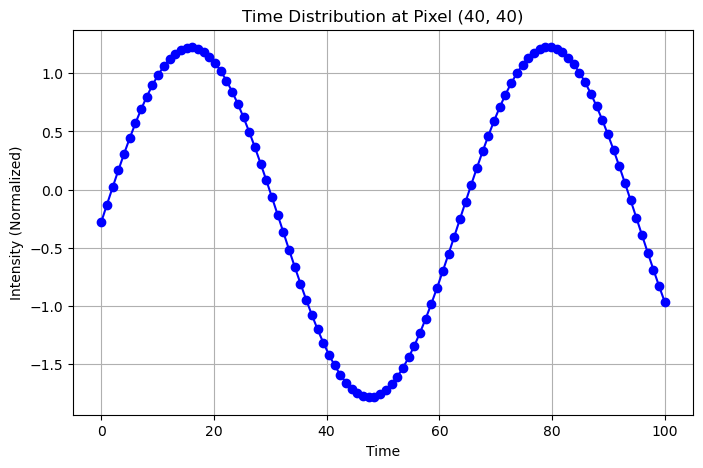

In [9]:
# Normalize the time distribution for visualization
norm_img_distribution = circle_distribution / np.max(circle_distribution)

# Define time bins
time_bins =  np.linspace(0, t_steps, t_steps)

# Choose a single pixel for visualization (example: center of the image)
pixel_distribution = (circle_distribution[40, 40, :] - np.mean(circle_distribution[40, 40, :])) / np.std(circle_distribution[40, 40, :])

get_distribution(time_bins, pixel_distribution, 40, 40)

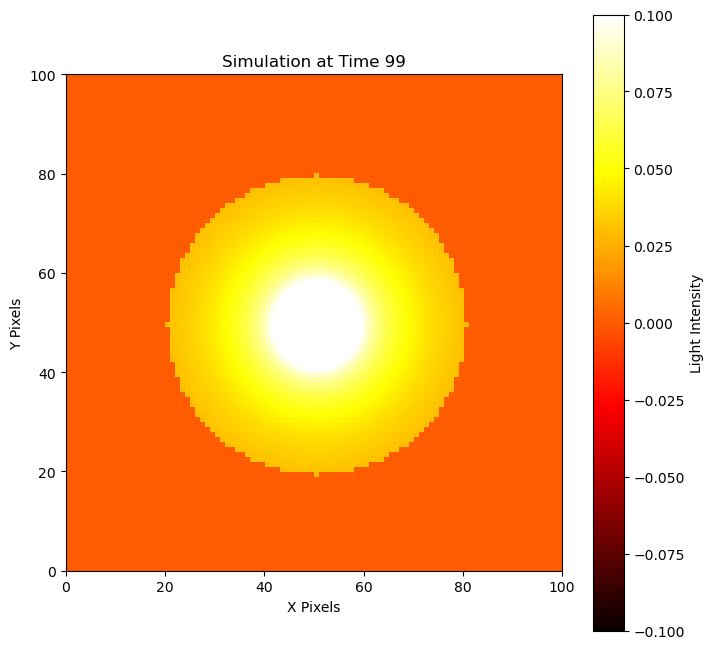

In [10]:
circle_ani = animated_plot(circle_distribution, t_steps)

HTML(circle_ani.to_jshtml())

## Random Gaussian Noise Distribution

In [11]:
# Create an array to store the image sequence
random_distribution = np.zeros((m, n, t_steps))

# Generate images over time
for t in range(t_steps):
    # Simulate some Gaussian noise with time-varying properties
    random_distribution[:, :, t] = np.random.normal(loc=0.5, scale=0.1 + 0.05 * np.sin(t / 5.0), size=(m, n))

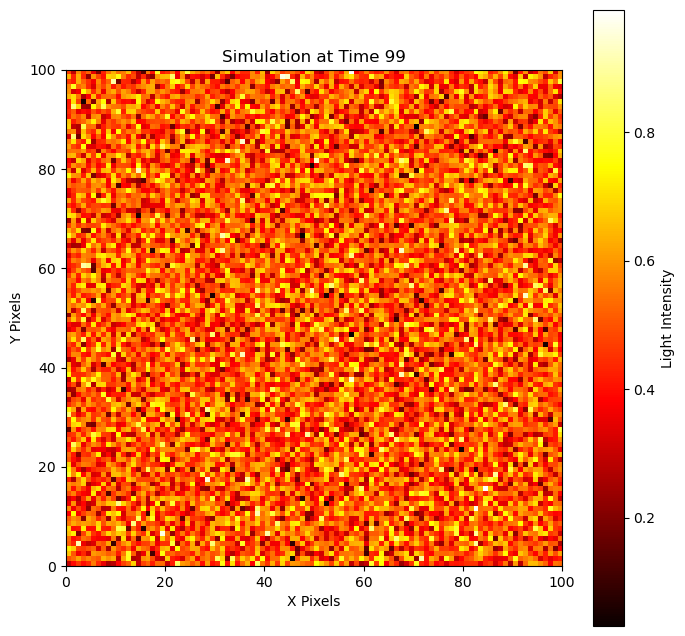

In [12]:
random_ani = animated_plot(random_distribution, t_steps)

HTML(random_ani.to_jshtml())

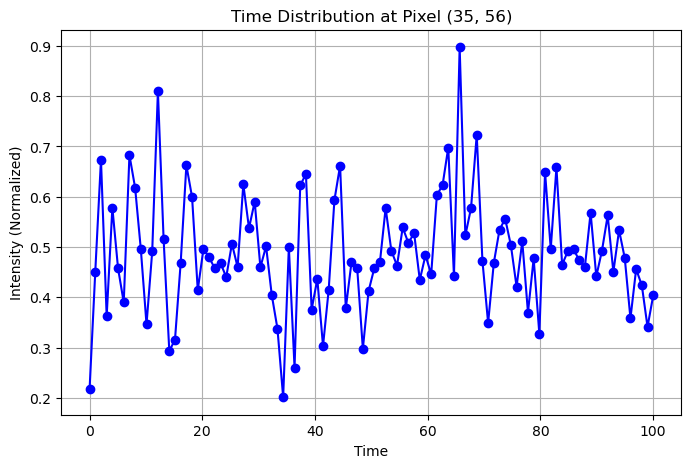

In [14]:
get_distribution(time_bins, random_distribution[35, 56, :], 35, 56)

## Perlin Noise Distribution

In [15]:
scale = 10        # Scale of the Perlin noise
octaves = 6       # Perlin noise octaves
persistence = 0.5 # Persistence for Perlin noise
lacunarity = 2.0  # Lacunarity for Perlin noise

In [16]:
# Generate structured noisy image using Perlin noise
def generate_perlin_noise_image(t, size=(m, n), scale=10, octaves=6, persistence=0.5, lacunarity=2.0):
    image = np.zeros(size)
    
    # Generate Perlin noise for each pixel
    for i in range(size[0]):
        for j in range(size[1]):
            # Calculate Perlin noise value for the given pixel location
            noise_value = pnoise2(i / scale, j / scale, octaves=octaves,
                                  persistence=persistence, lacunarity=lacunarity,
                                  repeatx=1024, repeaty=1024, base=t)
            # Normalize and add to the image
            image[i, j] = noise_value
            
    return image

In [17]:
# Initialize a 3D array to store image sequence (m, n, t_steps)
perlin_distribution = np.zeros((m, n, t_steps))

# Generate images over time with evolving noise
for t in range(t_steps):
    # Generate structured noisy image for the current time step
    noise_image = generate_perlin_noise_image(t)
    
    # Normalize the image to ensure pixel values are between 0 and 1
    perlin_distribution[:, :, t] = np.clip(noise_image, -1, 1)

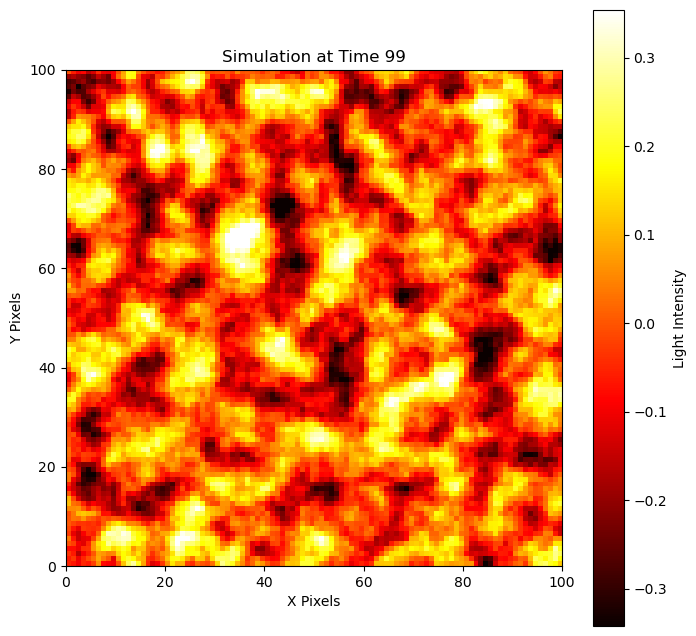

In [18]:
perlin_ani = animated_plot(perlin_distribution, t_steps)

HTML(perlin_ani.to_jshtml())

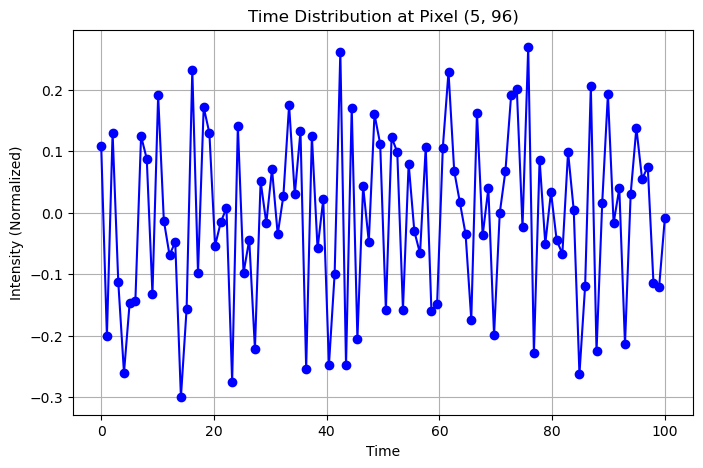

In [19]:
get_distribution(time_bins, perlin_distribution[5, 96, :], 5, 96)